# Imports

In [57]:
import re
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(rc={"figure.dpi":300})
pd.options.mode.chained_assignment = None

# Read Data

In [2]:
df_variants = pd.read_csv("../data/MAESTRO-d6178bdd-identified_variants_merged_protein_regions-main.tsv", sep="\t", low_memory=False)
df_keep = pd.read_csv("../data/important_variant_peptides.tsv", sep="\t")

In [3]:
patient_keep = [x for x in df_keep["patient_id"]]

In [4]:
df_variants.head()

,rowid,ccms_row_id,Algorithm,Filename,Cluster_index,Peptide,Unmodified_sequence,Charge,_dyn_#Intensity_for_cluster,_dyn_#Intensity_for_unmodified_sequence,...,PSP_site_match,DrugBank_drugs,Parent_mass,Num_PSP_Drugbank_events,Start_AA_1_based,End_AA_1_based,Num_spectra_for_cluster,Num_spectra_for_unmodified_sequence,Num_spectra_for_peptide_variant,Internal_ref_orig_intensity
0,1,1,.MODA.,specs_ms.mgf,960991,"K.[304.207]GARLIPEMDQIFTEVEMTTLE(K,304.207).V",.GARLIPEMDQIFTEVEMTTLEK.,4,36.905893,36.905893,...,NaN,NaN,1580.81,0,NaN,NaN,1,1,1,8.204159e+03
1,2,2,.MODA.,specs_ms.mgf,763982,"I.[304.207]FTEVEMTTLE(K,304.207).V",.FTEVEMTTLEK.,3,11.686782,11.686782,...,NaN,NaN,1934.91,0,NaN,NaN,1,2,2,4.936894e+05
2,3,3,.MSGFPLUS.,specs_ms.mgf,902201,K.[304.207]LYQPEYQEVSTEEQR.E,.LYQPEYQEVSTEEQR.,3,15.690234,15.690234,...,NaN,NaN,2203.09,0,NaN,NaN,5,6,6,1.951566e+05
3,4,4,.MSGFPLUS.,specs_ms.mgf,935503,"K.[304.207]AANSLEAFIFETQD(K,304.207).L",.AANSLEAFIFETQDK.,3,15.016824,15.016824,...,NaN,NaN,2292.24,0,NaN,NaN,3,4,4,2.877781e+06
4,5,5,.MODA.,specs_ms.mgf,297961,"R.[304.207]YSHDF(N,-56.985)FH.I",.YSHDFNFH.,3,33.768015,33.768015,...,NaN,NaN,1313.66,0,NaN,NaN,3,3,3,7.088440e+04


In [5]:
df_variants[df_variants["ccms_row_id"] == 58286]["Peptide"].values[0]

'K.[304.207](K,304.207)QTALVELV(K,520.821)H(K,304.207).P'

In [6]:
df_T = df_variants[['Peptide'] + [c for c in df_variants.columns if 'intensity_for_peptide_variant' in c]]
df_T.replace(0.0, np.nan, inplace=True)
df_T = df_T.set_index("Peptide")
df_T = df_T.T
df_T.index = df_T.index.map(lambda x: ".".join(x.split(".")[:2]))
df_T.index = df_T.index.map(lambda x: x.split("_dyn_#")[-1])
df_T["Condition"] = df_T.index.map(lambda x: x.split(".")[0])
df_T = df_T[(df_T.Condition != "_dyn_#Empty")]

In [7]:
df_T["Peptide"] = df_T.index
df_T["keep"] = df_T["Peptide"].map(lambda x: x.split(".")[-1])
df_T["keep"] = df_T["keep"].map(lambda x: x in patient_keep)
df_T = df_T[(df_T.keep == True)]

In [8]:
df_T

Peptide,"K.[304.207]GARLIPEMDQIFTEVEMTTLE(K,304.207).V","I.[304.207]FTEVEMTTLE(K,304.207).V",K.[304.207]LYQPEYQEVSTEEQR.E,"K.[304.207]AANSLEAFIFETQD(K,304.207).L","R.[304.207]YSHDF(N,-56.985)FH.I","R.[304.207](P,143.096)SV(C,57.021)REAGPQAHMQQVTSSL(K,304.207).G",K.[304.207]QGSTGEEFHFQTGGR.D,"K.[304.207]HGTDDGVVW(M,15.995)NW(K,304.207).G","K.[304.207](H,100.027)GTDDGVVWMNW(K,304.207).G","K.[304.207]H(G,304.213)TDDGVVWMNW(K,304.207).G",...,"K.[304.207]YLGEE(Y,-60.599)V(K,304.207).A","K.[304.207]YLGEE(Y,-63.608)V(K,304.207).A","K.[304.207]YLGE(E,-68.078)YV(K,304.207).A","K.[304.207]YL(G,55.921)EEYV(K,304.207).A","K.{187.018}[304.207]YLGEEYV(K,304.207).A","R.[304.207]NTYE(K,361.237)YLGEEYV(K,304.207).A","K.[304.207]YLGE(E,125.898)YV(K,304.207).A",Condition,Peptide,keep
Healthy.HC1,NaN,NaN,0.935916,NaN,NaN,NaN,NaN,NaN,NaN,0.288821,...,NaN,1.174198,NaN,NaN,NaN,0.370040,NaN,Healthy,Healthy.HC1,True
Healthy.HC10,6.645649,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.026024,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Healthy,Healthy.HC10,True
Healthy.HC12,3.391896,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.009033,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Healthy,Healthy.HC12,True
Healthy.HC13,1.919552,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.028415,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Healthy,Healthy.HC13,True
Healthy.HC17,NaN,NaN,0.286530,1.259306,NaN,NaN,NaN,NaN,NaN,NaN,...,0.863862,NaN,NaN,NaN,NaN,0.791905,NaN,Healthy,Healthy.HC17,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Symptomatic-non-COVID-19.JBDZ5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.57320,0.701235,0.036201,...,NaN,NaN,NaN,NaN,0.202111,NaN,0.207968,Symptomatic-non-COVID-19,Symptomatic-non-COVID-19.JBDZ5,True
Symptomatic-non-COVID-19.JBDZ6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.62278,0.613630,0.020799,...,NaN,NaN,NaN,NaN,0.143696,NaN,0.118712,Symptomatic-non-COVID-19,Symptomatic-non-COVID-19.JBDZ6,True
Symptomatic-non-COVID-19.JBDZ7,NaN,0.435434,0.200232,NaN,NaN,NaN,NaN,NaN,NaN,0.061746,...,NaN,NaN,0.670534,0.304344,NaN,NaN,NaN,Symptomatic-non-COVID-19,Symptomatic-non-COVID-19.JBDZ7,True
Symptomatic-non-COVID-19.JBDZ8,NaN,0.736280,0.170478,NaN,NaN,NaN,NaN,NaN,NaN,0.074855,...,NaN,NaN,1.330314,0.532133,NaN,NaN,NaN,Symptomatic-non-COVID-19,Symptomatic-non-COVID-19.JBDZ8,True


# Top Peptides

In [9]:
top_ids = [42727, 53107, 58286, 58283, 70224, 10605, 57428, 48133]
top_peptides = [df_variants[df_variants.ccms_row_id == idx]["Peptide"].values[0] for idx in top_ids]

In [10]:
top_peptides

['N.[304.207](P,52.514)VQRILGGHLDA(K,304.207).G',
 'R.[304.207]SYS(C,57.021)QVTH(E,148.084)GSTVE(K,304.207).T',
 'K.[304.207](K,304.207)QTALVELV(K,520.821)H(K,304.207).P',
 'K.[304.207](K,304.207)QTALVELV(K,522.33)H(K,304.207).P',
 'S.[236.123]LHTLFGD(K,304.207).L',
 'K.[304.207]GFYPSDIAVEWE(S,78.09)NGQPENNY(K,304.207).T',
 'K.[304.207](C,85.056)(C,57.021)TESLVNR.R',
 'K.[304.207]YTTTSSSSR.K']

In [16]:
variants = []

for peptide in top_peptides:
    top_peptide = peptide
    peptide = re.sub('[^A-Z]+', '', peptide)
    temp_list = [top_peptide]
    for c in df_T.columns:
        if re.sub('[^A-Z]+', '', c) == peptide and c != top_peptide:
            temp_list += [c]
    variants += [temp_list]

In [17]:
variants[0]

['N.[304.207](P,52.514)VQRILGGHLDA(K,304.207).G',
 'N.[304.207](P,51.014)VQRILGGHLDA(K,304.207).G',
 'N.[304.207](P,48.73)VQRILGGHLDA(K,304.207).G',
 'N.[304.207]PVQRILGGHLDA(K,304.207).G',
 'N.[304.207]PV(Q,-47.974)RILGGHLDA(K,304.207).G']

# Heat Map

In [18]:
def z_score(df):
    df_std = df.copy()
    for col in df_std.columns:
        df_std[col] = (df_std[col] - df_std[col].mean()) / df_std[col].std()
        df_std[col] = df_std[col].map(lambda x: x if np.isnan(x) else min(3, max(-3, x)))
    return df_std

In [77]:
for v in variants:
    print(len(v))

5
129
35
35
31
312
243
1


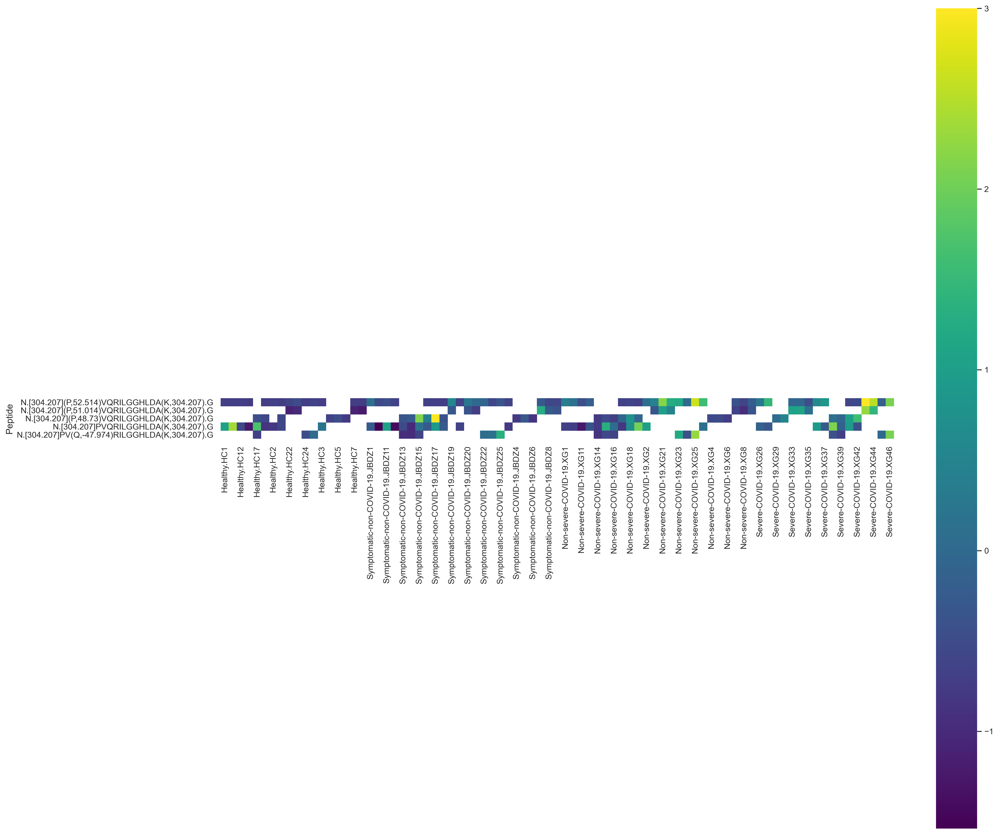

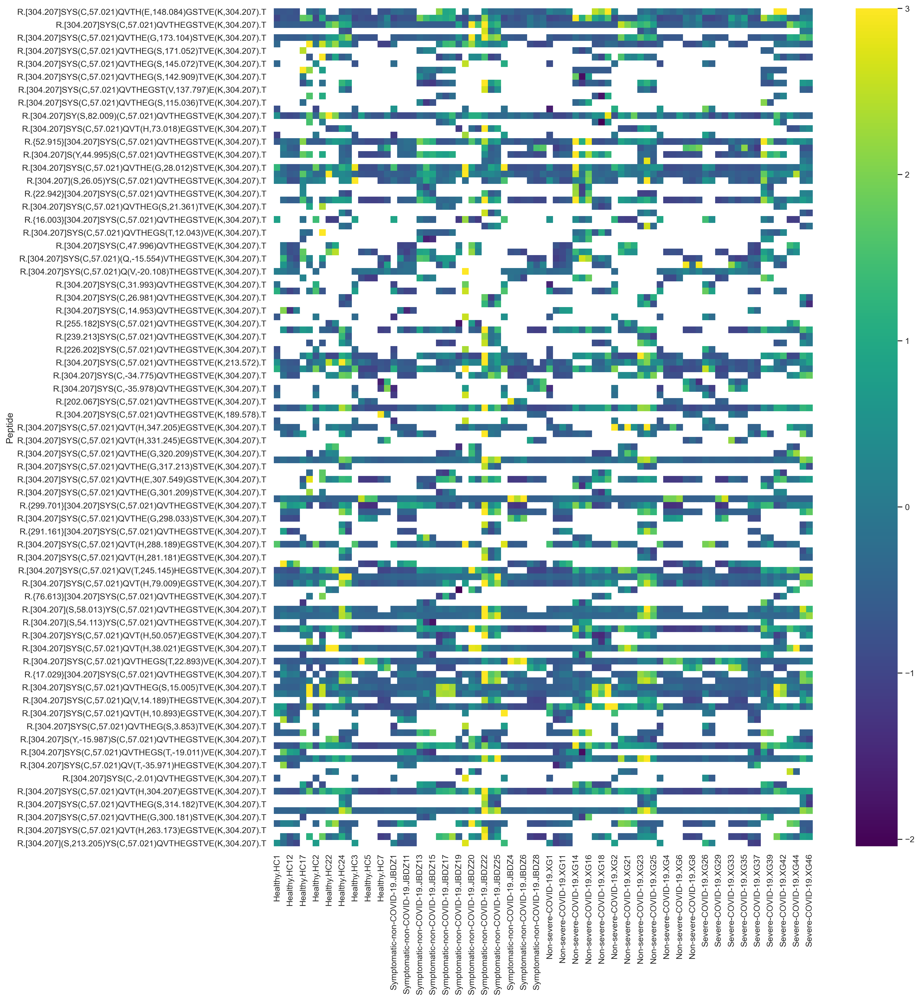

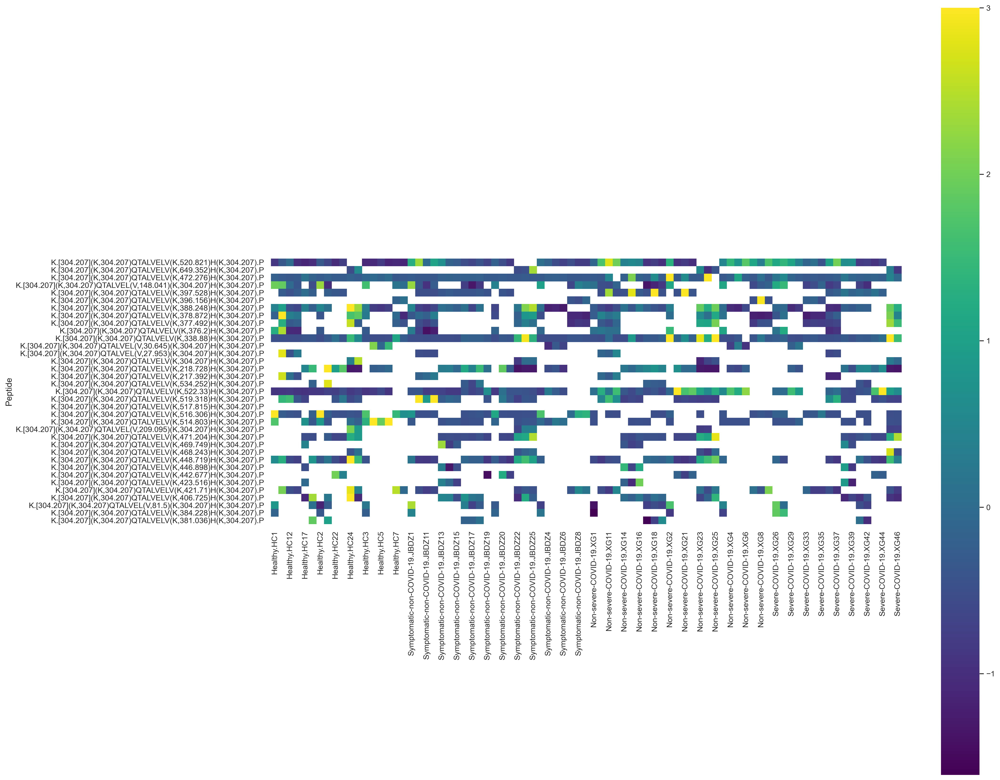

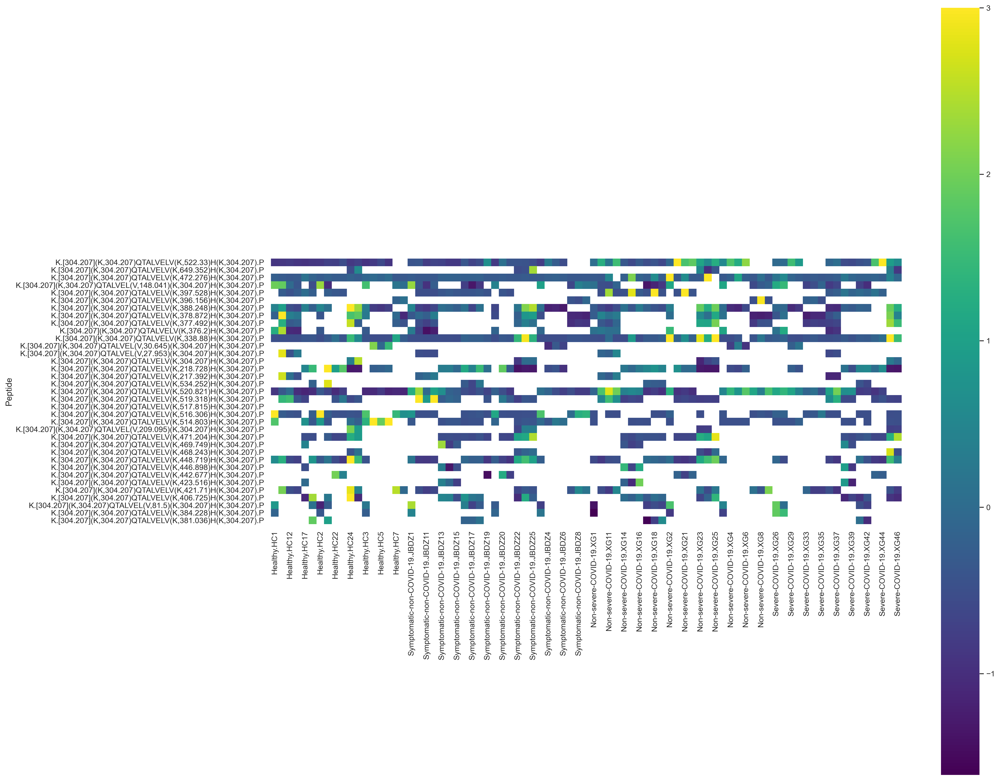

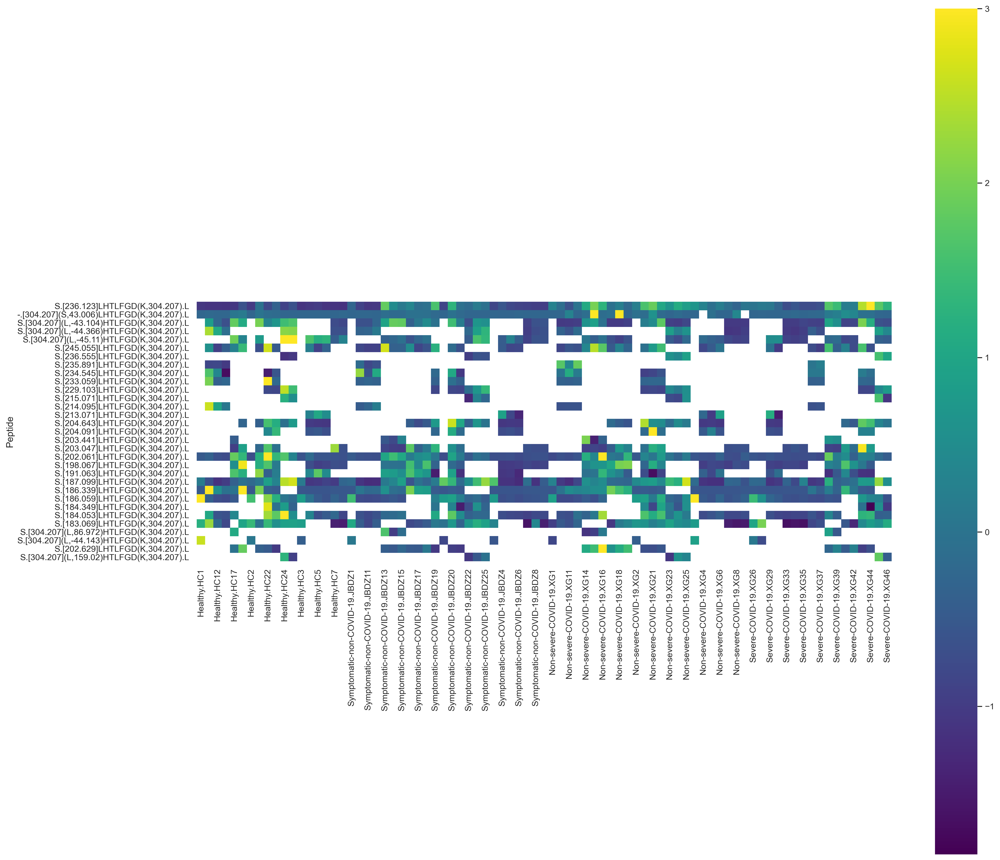

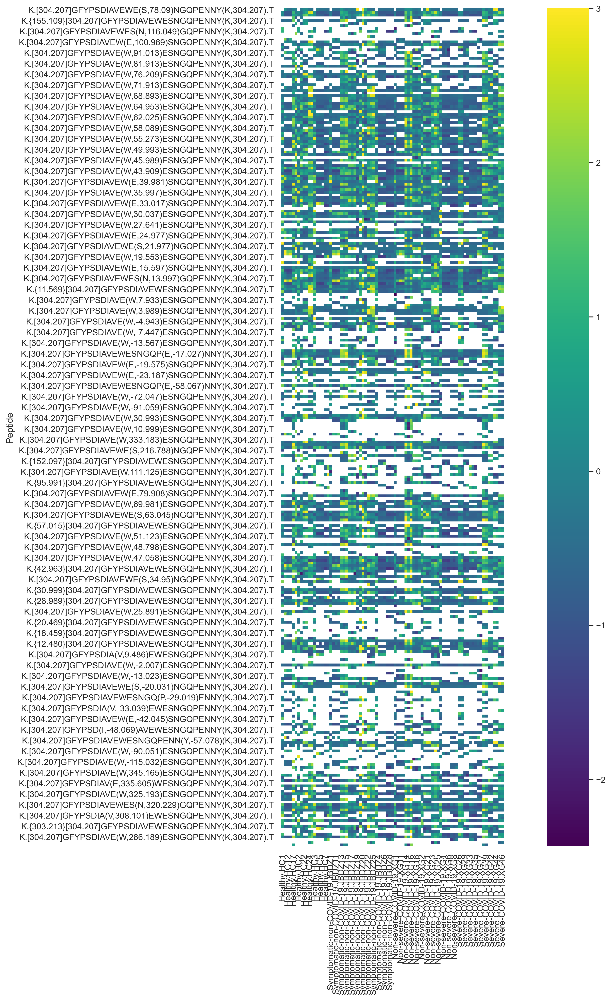

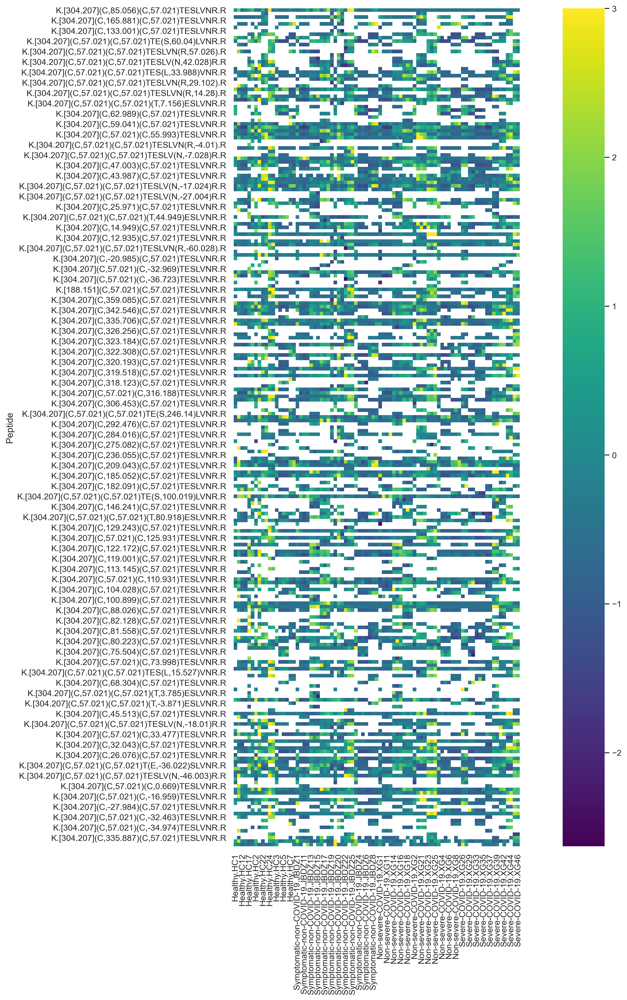

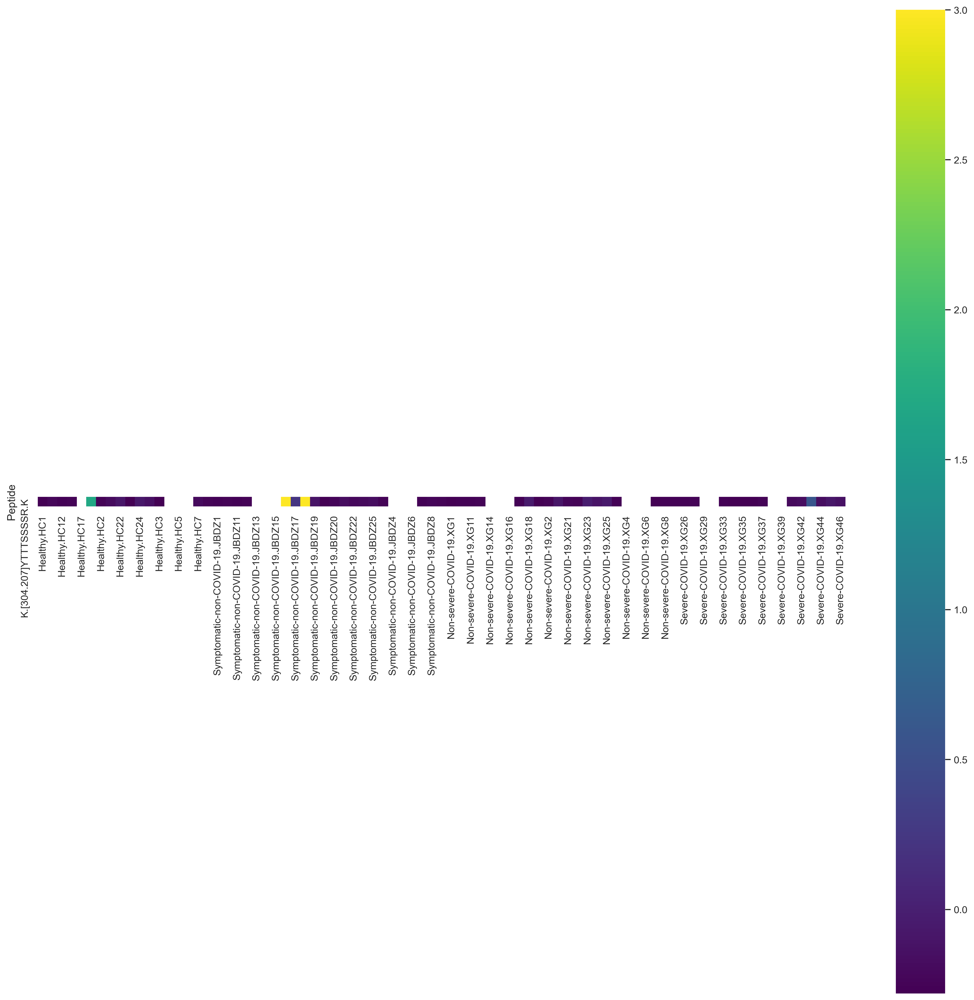

In [113]:
for v in range(len(variants)):
    L = variants[v]
    df_heatmap = df_T.copy()
    df_heatmap = df_heatmap.loc[:, list(L)]
    df_heatmap = z_score(df_heatmap)
    df_heatmap = df_heatmap.T
    
    # rearrange columns
    healthy, sym_non_COVID, COVID_non_severe, COVID_severe  = [], [], [], []
    for c in df_heatmap.columns:
        if "Healthy" in c:
            healthy += [c]
        elif "Symptomatic-non-COVID" in c:
            sym_non_COVID += [c]
        elif "Non-severe-COVID" in c:
            COVID_non_severe += [c]
        elif "Severe-COVID" in c:
            COVID_severe += [c]

    columns = healthy + sym_non_COVID + COVID_non_severe + COVID_severe
    df_heatmap = df_heatmap[columns]
    
    drop_row = []
    if len(df_heatmap) > 10:
        for i in range(1, len(df_heatmap)):
            if df_heatmap.iloc[i].isnull().sum() > 20:
                drop_row += [df_heatmap.iloc[i].name]
    df_heatmap_drop = df_heatmap.drop(drop_row)
    
    
    cmap = sns.color_palette("viridis", as_cmap=True)
    plt.figure(figsize=(20,20))
    with sns.axes_style("white"):
        print(df_heatmap.index[0])
        heatmap = sns.heatmap(df_heatmap, cmap=cmap, square=True)

<Figure size 6000x6000 with 0 Axes>

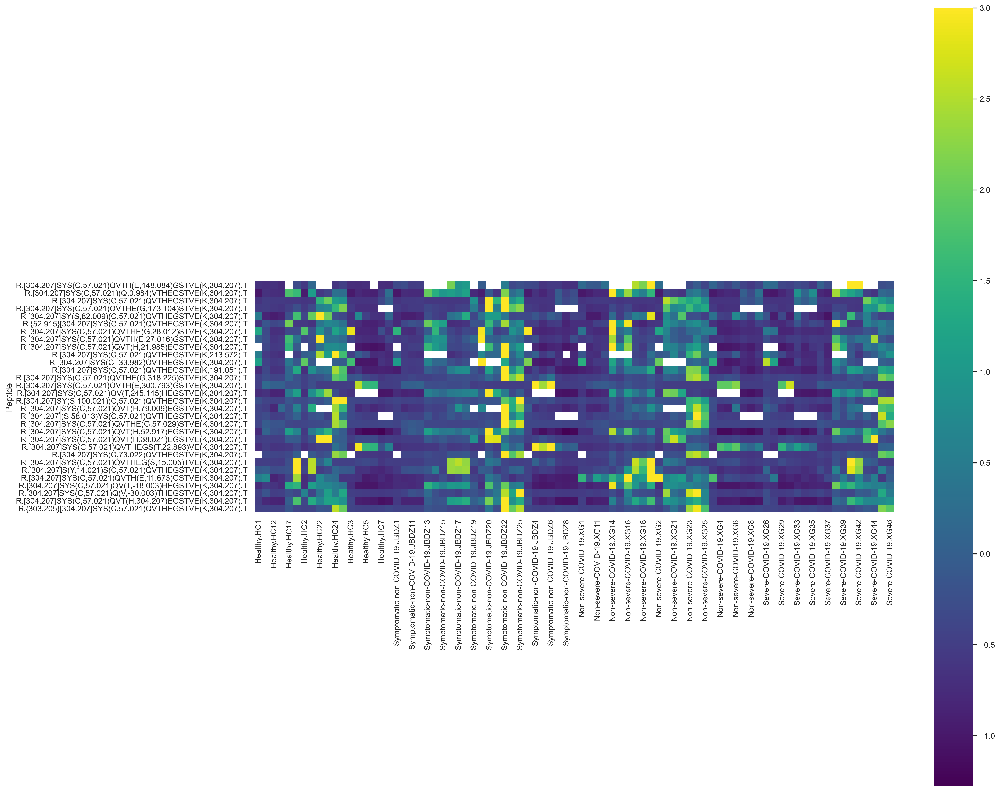

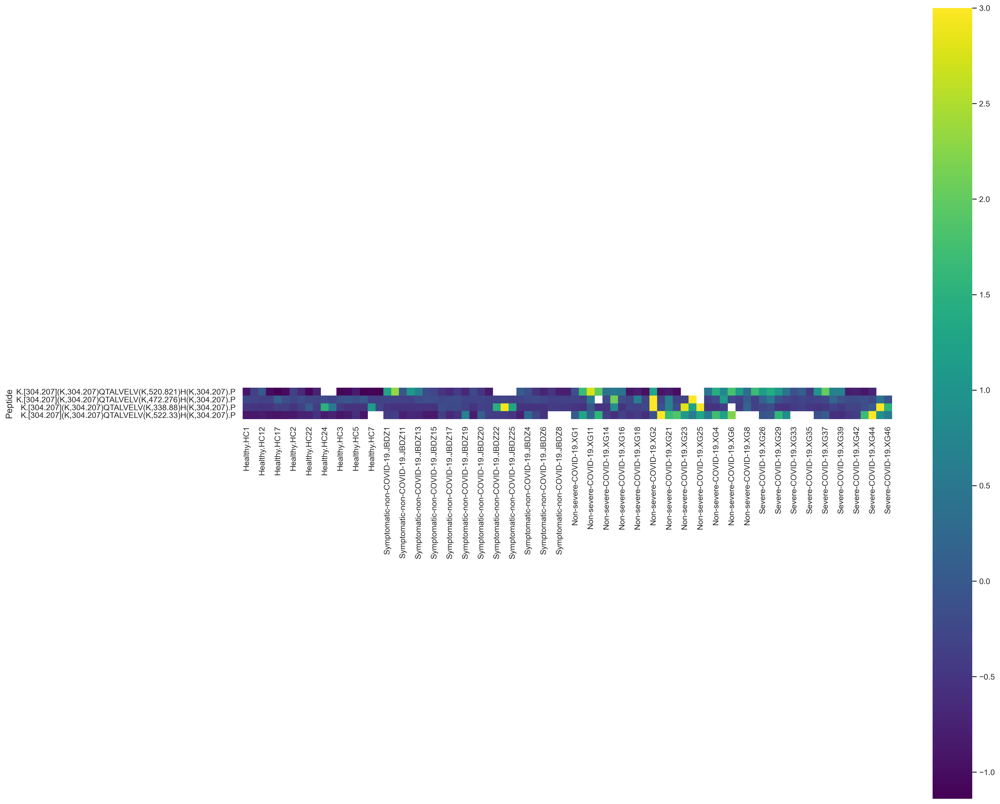

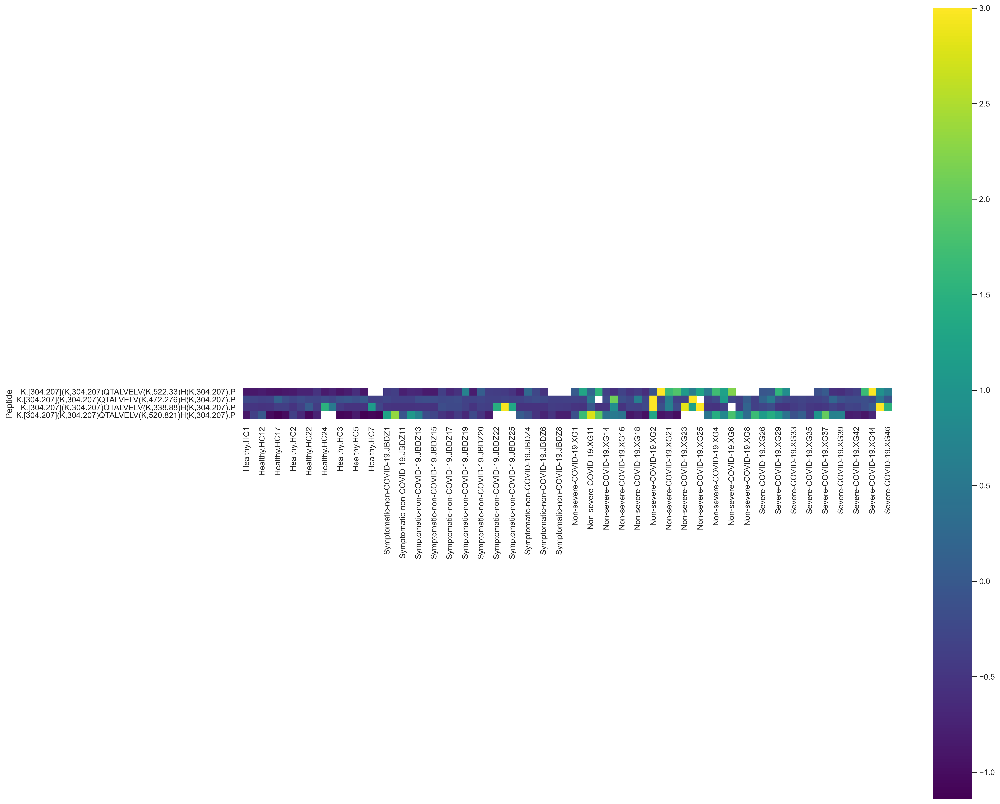

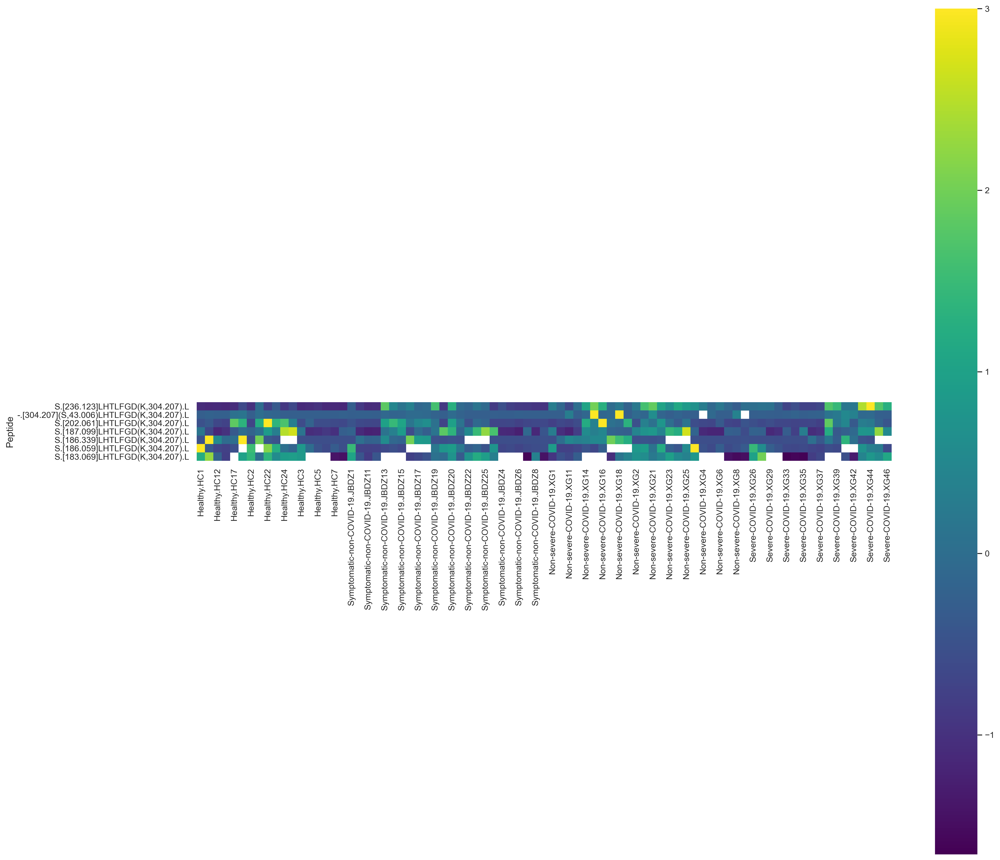

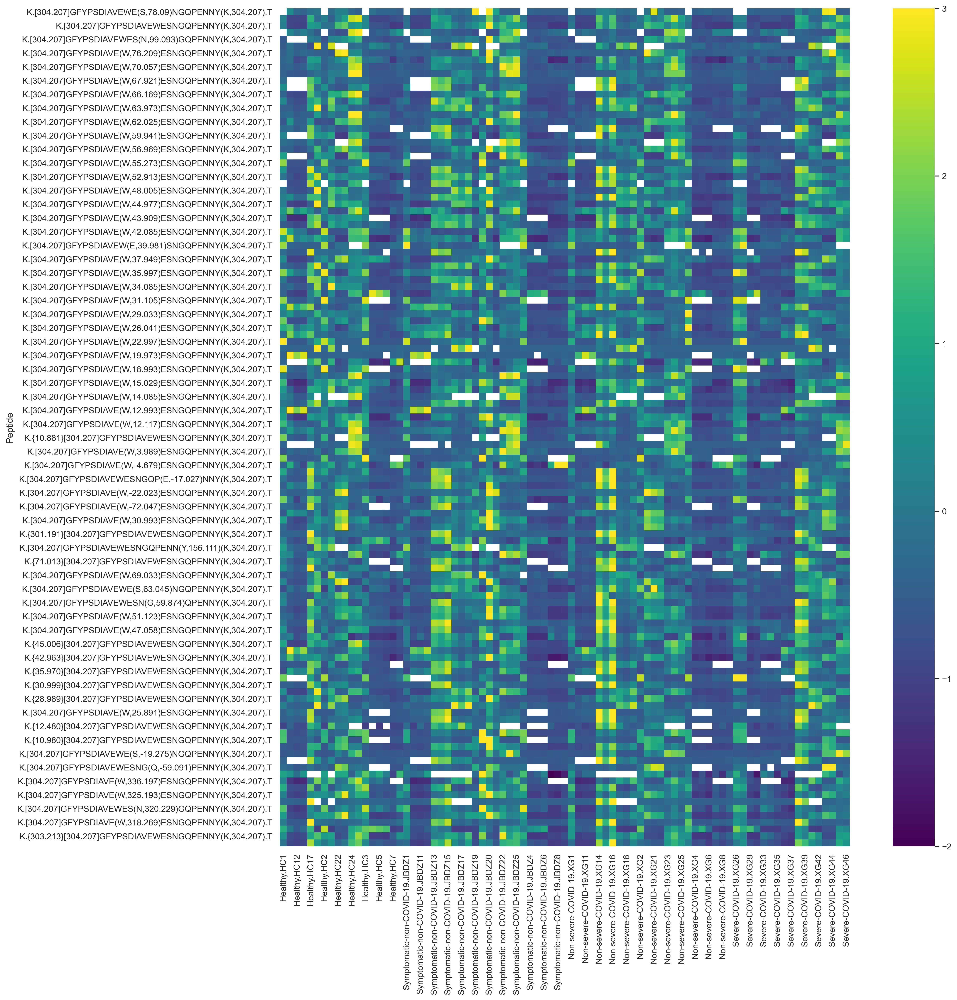

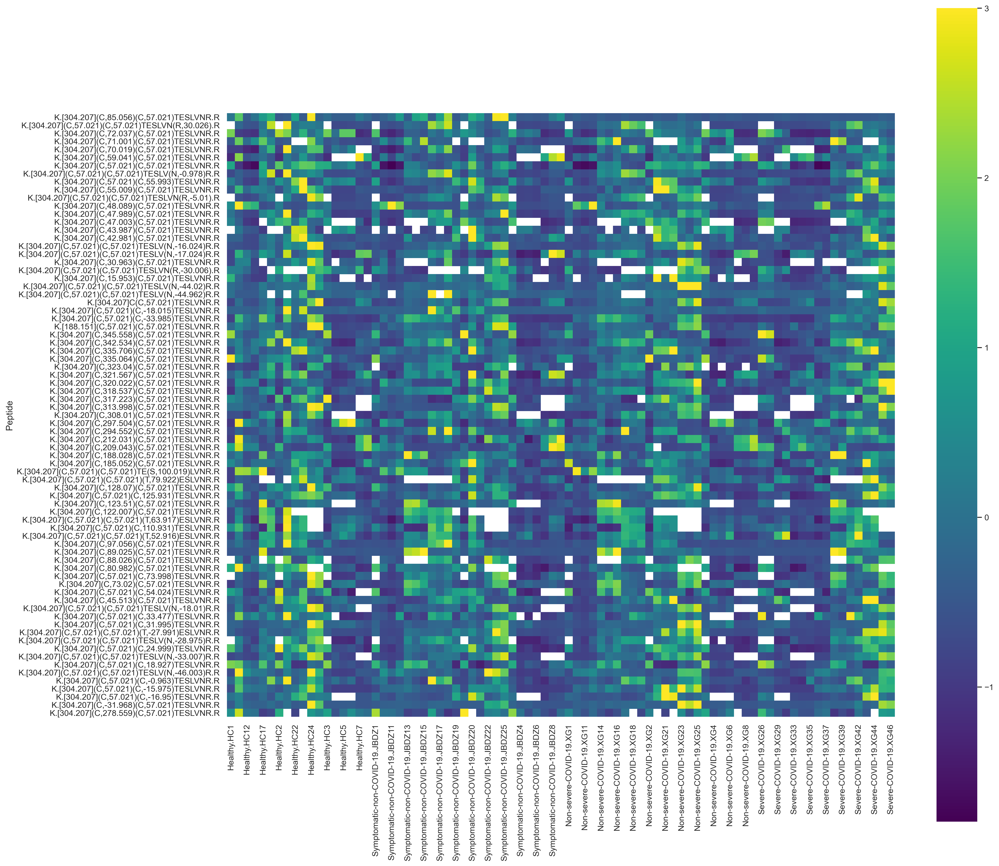

<Figure size 6000x6000 with 0 Axes>

In [112]:
for v in range(len(variants)):
    L = variants[v]
    df_heatmap = df_T.copy()
    df_heatmap = df_heatmap.loc[:, list(L)]
    df_heatmap = z_score(df_heatmap)
    df_heatmap = df_heatmap.T
    
    # rearrange columns
    healthy, sym_non_COVID, COVID_non_severe, COVID_severe  = [], [], [], []
    for c in df_heatmap.columns:
        if "Healthy" in c:
            healthy += [c]
        elif "Symptomatic-non-COVID" in c:
            sym_non_COVID += [c]
        elif "Non-severe-COVID" in c:
            COVID_non_severe += [c]
        elif "Severe-COVID" in c:
            COVID_severe += [c]

    columns = healthy + sym_non_COVID + COVID_non_severe + COVID_severe
    df_heatmap = df_heatmap[columns]
    
    drop_row = []
    if len(df_heatmap) > 10:
        for i in range(1, len(df_heatmap)):
            if df_heatmap.iloc[i].isnull().sum() > 20:
                drop_row += [df_heatmap.iloc[i].name]
    df_heatmap_drop = df_heatmap.drop(drop_row)
    
    
    cmap = sns.color_palette("viridis", as_cmap=True)
    plt.figure(figsize=(20,20))
    if drop_row:
        with sns.axes_style("white"):
            print(df_heatmap.index[0])
            heatmap_drop = sns.heatmap(df_heatmap_drop, cmap=cmap, square=True)